In [6]:
!pip install alphashape

Defaulting to user installation because normal site-packages is not writeable
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 535.2/535.2 kB 3.1 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 694.7/694.7 kB 14.2 MB/s eta 0:00:00a 0:00:01
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.


In [2]:
# Importaciones necesarias
from IPython.display import Image     # Import the Image function from IPython.display to display images in Jupyter environments.
from os import chdir                  # Import chdir from os module to change the current working directory.
from scipy.spatial import Delaunay    # Import Delaunay
import numpy as np                    # Import numpy library for working with n-dimensional arrays and mathematical operations.
import gudhi as gd                    # Import gudhi library for computational topology and computational geometry.
import matplotlib.pyplot as plt       # Import pyplot from matplotlib for creating visualizations and graphs.
import argparse                       # Import argparse, a standard library for writing user-friendly command-line interfaces.
import seaborn as sns                 # Import seaborn for data visualization; it's based on matplotlib and provides a high-level interface for drawing statistical graphs.
import requests                       # Import requests library to make HTTP requests in Python easily.
import pandas as pd                   # Import pandas for data manipulation and analysis.
from scipy.spatial.distance import pdist, squareform  # Import distance functions from scipy.spatial.distance
import os
from os import path, makedirs
from scipy.spatial import Voronoi, voronoi_plot_2d, Delaunay, delaunay_plot_2d
from alphashape import alphashape

In [3]:
import os
import requests
import csv
#Ruta del directorio que contiene los archivos CSV
ruta_directorio = "/home/jupyter-alumno15/celulas/carpeta_csv"

# Obtener una lista de todos los archivos CSV en la ruta especificada
archivos_csv = [archivo for archivo in os.listdir(ruta_directorio) if archivo.endswith('.csv')]

# Iterar sobre cada archivo CSV
for archivo_csv in archivos_csv:
    # Construir la ruta completa del archivo
    ruta_completa = os.path.join(ruta_directorio, archivo_csv)
    
    # Leer el archivo CSV y asignar nombres de columnas
    df = pd.read_csv(ruta_completa, header=None)
    nombres_columnas = ['id', 'Tipo', 'X', 'Y', 'Z']  # Reemplazar con los nombres de columnas apropiados
    df.columns = nombres_columnas
    
    # Mostrar las primeras filas del DataFrame
    print("Contenido de", archivo_csv)
    print(df.head(5))
    
    # Contar el número de IDs distintos
    num_ids_distintos = df['id'].nunique()
    print("Número de IDs distintos:", num_ids_distintos)

FileNotFoundError: [Errno 2] No such file or directory: '/home/jupyter-alumno15/celulas/carpeta_csv'

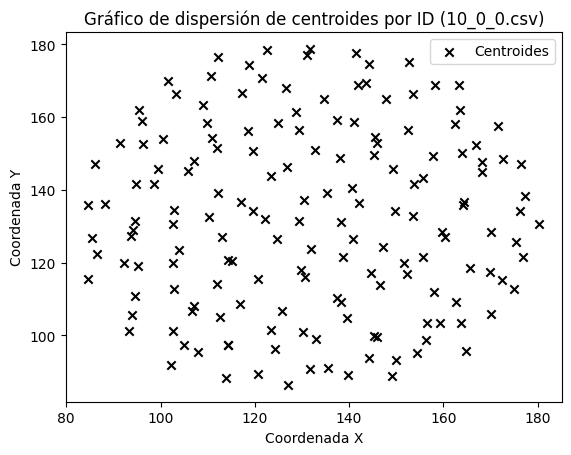

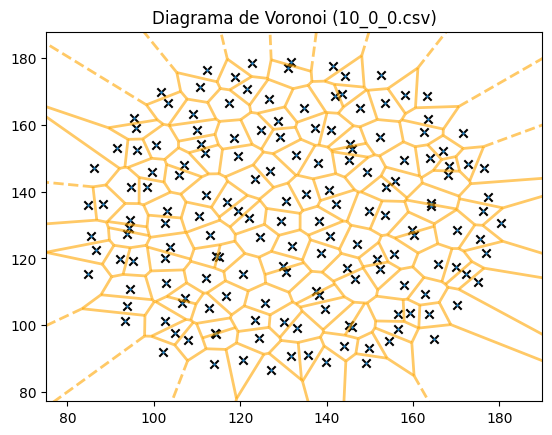

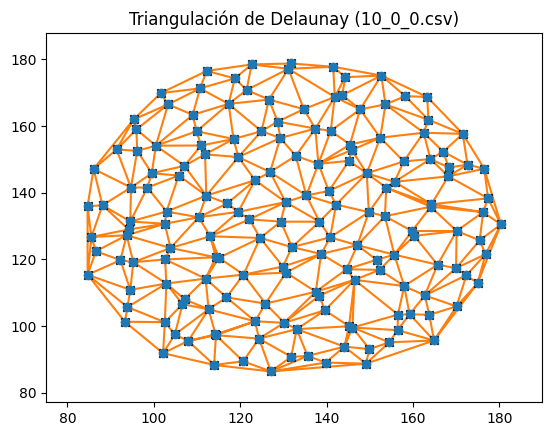

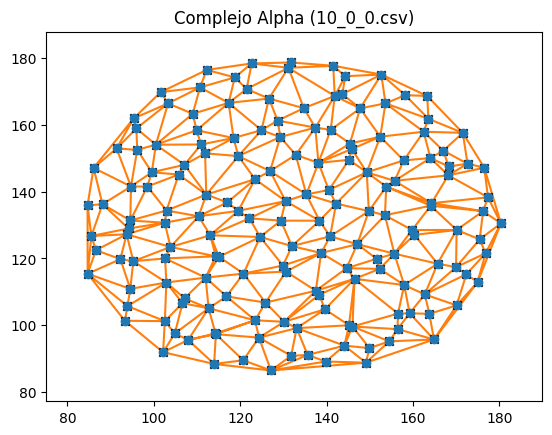

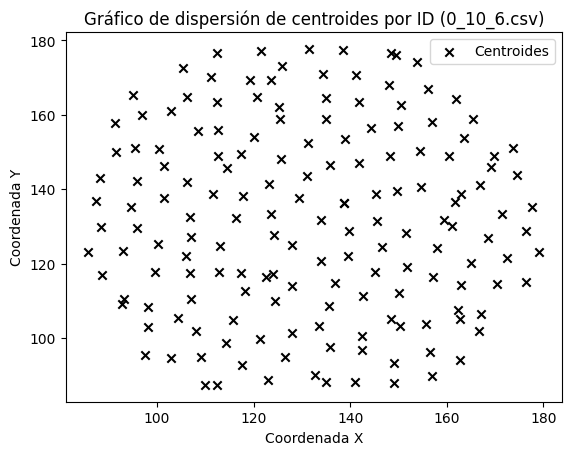

...

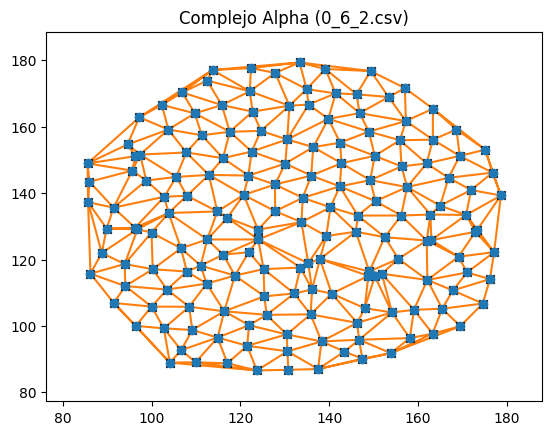

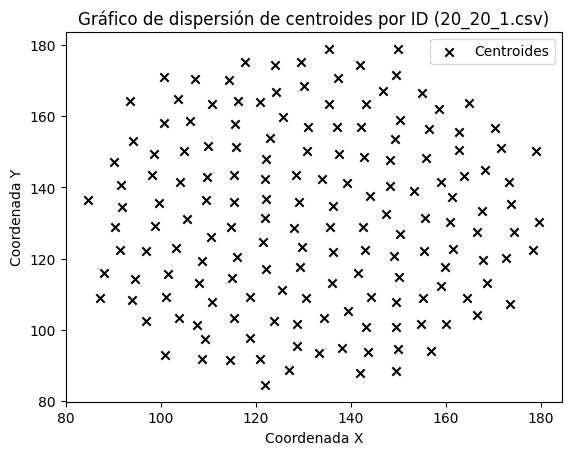

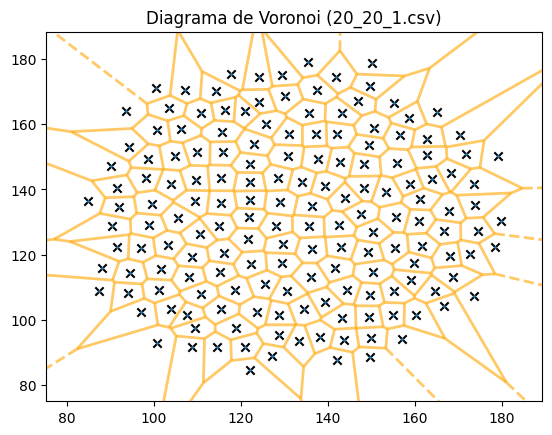

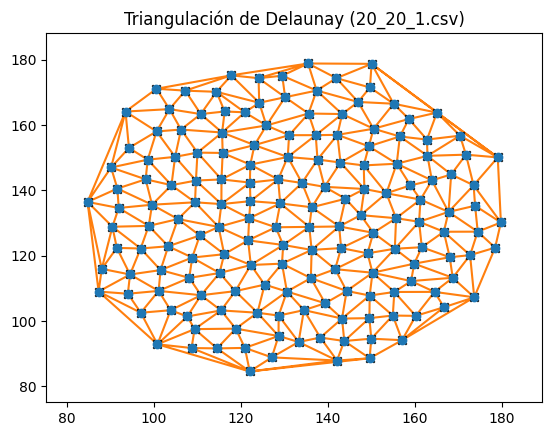

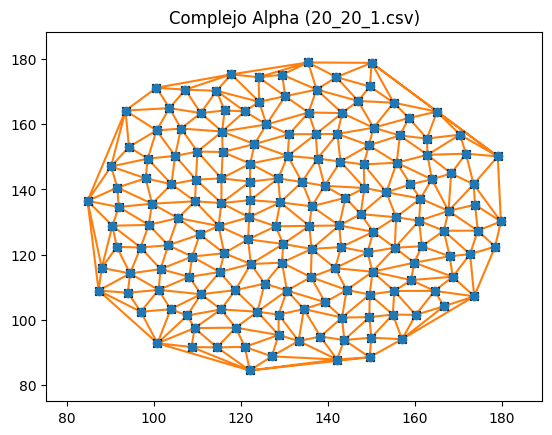

In [11]:
# Crear la carpeta para las imágenes si no existe
output_dir = "Datos_im"
os.makedirs(output_dir, exist_ok=True)

# Iterar sobre cada archivo CSV
for archivo_csv in archivos_csv:
    # Construir la ruta completa del archivo
    ruta_completa = os.path.join(ruta_directorio, archivo_csv)
    
       # Leer el archivo CSV y asignar nombres de columnas
    df = pd.read_csv(ruta_completa, header=None)
    nombres_columnas = ['id', 'Tipo', 'X', 'Y', 'Z']  # Reemplazar con los nombres de columnas apropiados
    df.columns = nombres_columnas
    
    
    # Agrupar los datos por el ID
    grupos = df.groupby('id')
    
    # Inicializar listas para almacenar los centroides
    centroides_x = []
    centroides_y = []
    
    # Calcular el centroide para cada grupo
    for id_grupo, grupo in grupos:
        X_grupo = grupo['X']
        Y_grupo = grupo['Y']
        centroid_x_grupo = X_grupo.mean()
        centroid_y_grupo = Y_grupo.mean()
        centroides_x.append(centroid_x_grupo)
        centroides_y.append(centroid_y_grupo)
    
    # Crear el gráfico de dispersión solo con los centroides
    plt.scatter(centroides_x, centroides_y, color='black', marker='x', label='Centroides')  # Agregar los centroides al gráfico
    plt.xlabel('Coordenada X')
    plt.ylabel('Coordenada Y')
    plt.title(f'Gráfico de dispersión de centroides por ID ({archivo_csv})')
    plt.legend()  # Mostrar la leyenda con la etiqueta de los centroides
    plt.show()

        # Generar los diagramas para los centroides
    points = np.column_stack((centroides_x, centroides_y))
    
     # Diagrama de Voronoi
    vor = Voronoi(points)
    fig, ax = plt.subplots()
    voronoi_plot_2d(vor, ax=ax, show_vertices=False, line_colors='orange', line_width=2, line_alpha=0.6, point_size=2)
    plt.scatter(centroides_x, centroides_y, color='black', marker='x')
    plt.title(f'Diagrama de Voronoi ({archivo_csv})')
    plt.savefig(os.path.join(output_dir, f'diagrama_voronoi_{os.path.basename(archivo_csv)}.png'))
    plt.show()

    # Triangulación de Delaunay
    delaunay_tri = Delaunay(points)
    fig, ax = plt.subplots()
    delaunay_plot_2d(delaunay_tri, ax=ax)
    plt.scatter(centroides_x, centroides_y, color='black', marker='x')
    plt.title(f'Triangulación de Delaunay ({archivo_csv})')
    plt.savefig(os.path.join(output_dir, f'triangulacion_delaunay_{os.path.basename(archivo_csv)}.png'))
    plt.show()

    # Complejo Alpha (aproximación con Delaunay)
    fig, ax = plt.subplots()
    delaunay_plot_2d(delaunay_tri, ax=ax)
    plt.scatter(centroides_x, centroides_y, color='black', marker='x')
    plt.title(f'Complejo Alpha ({archivo_csv})')
    plt.savefig(os.path.join(output_dir, f'complejo_alpha_{os.path.basename(archivo_csv)}.png'))
    plt.show()

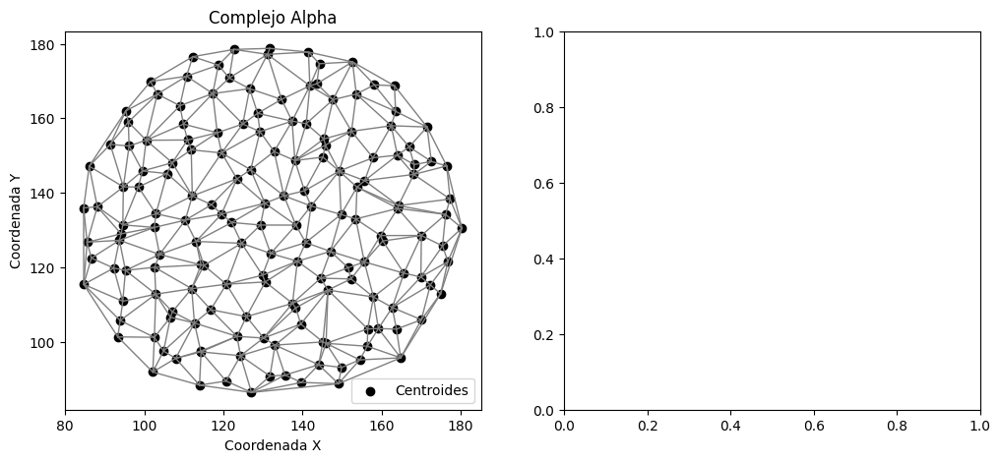

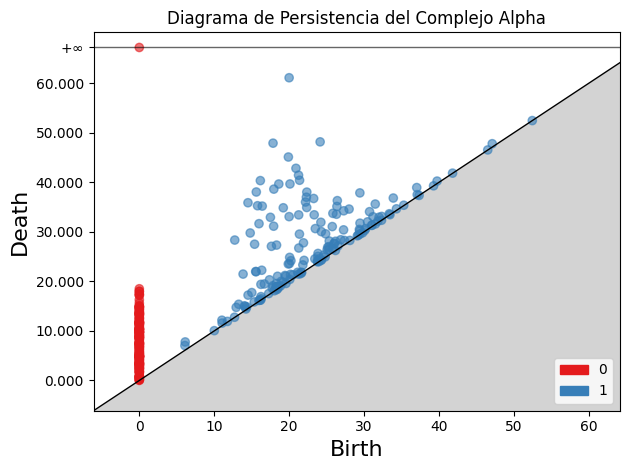

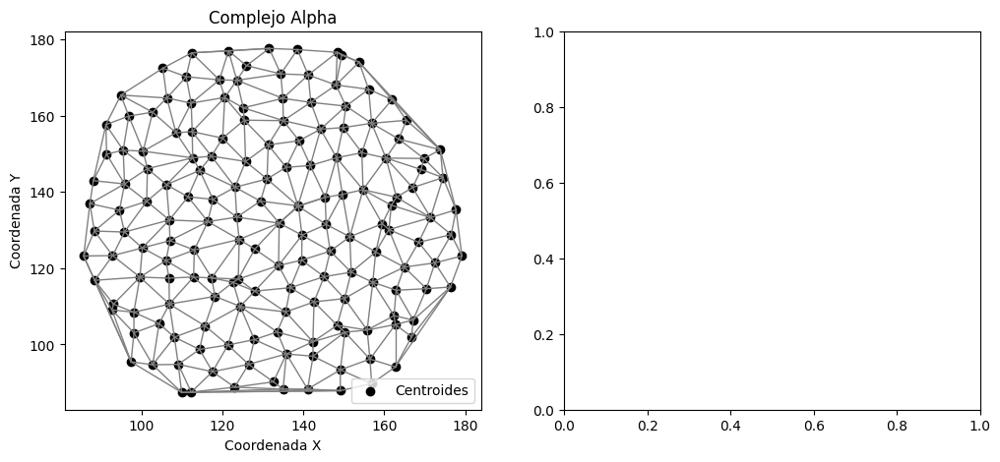

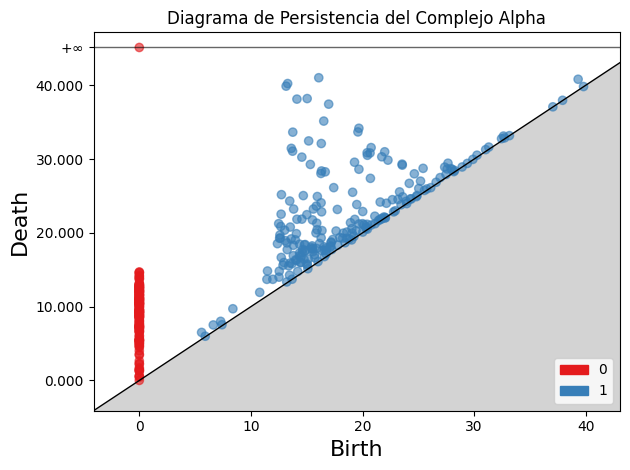

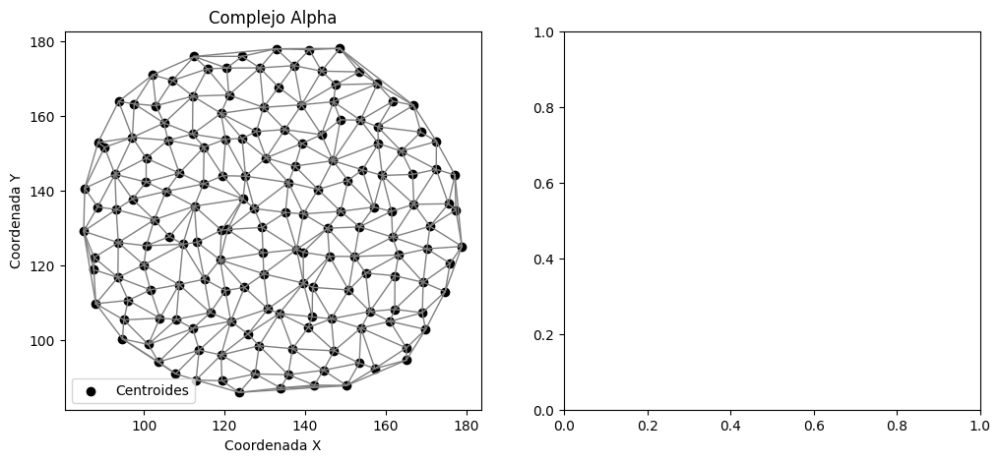

...

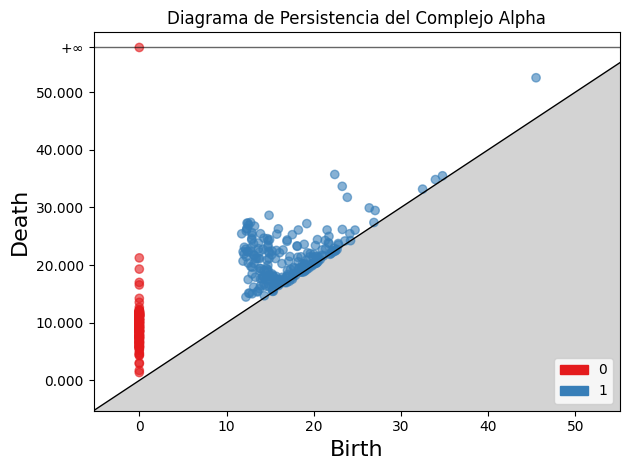

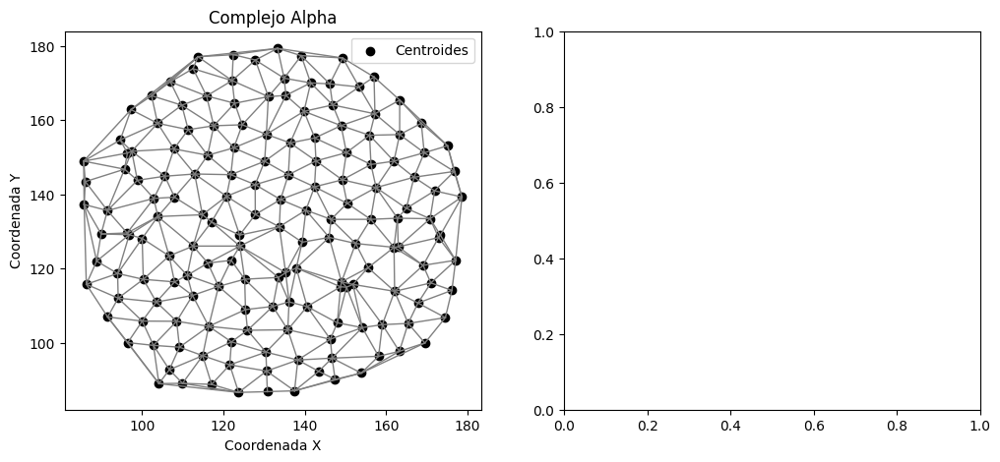

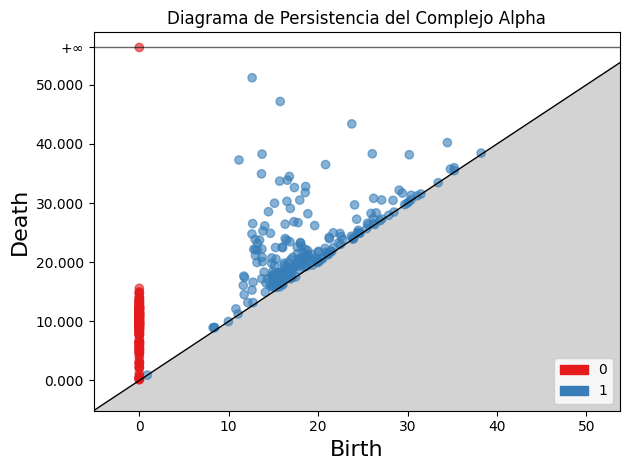

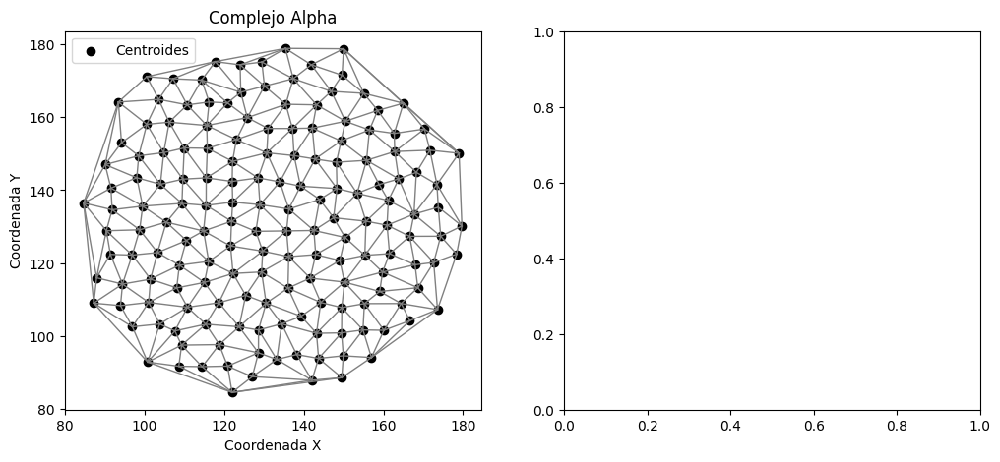

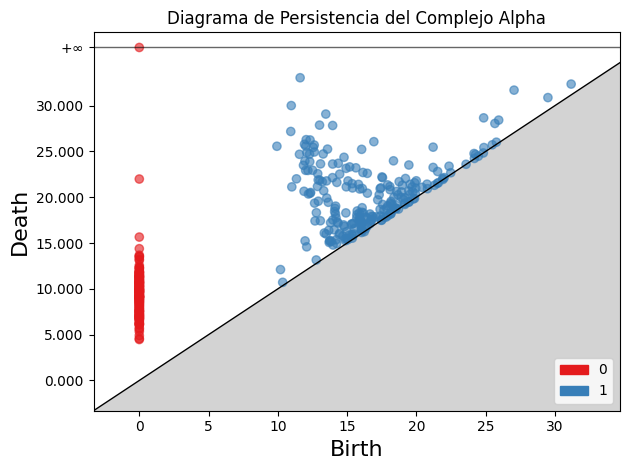

Distancia de Bottleneck (Dimensión 1) para 10_0_0.csv es efectivamente cero.
Distancia de Bottleneck (Dimensión 0) para 10_0_0.csv es efectivamente cero.
Distancia de Bottleneck (Dimensión 1) para 0_10_6.csv es efectivamente cero.
Distancia de Bottleneck (Dimensión 0) para 0_10_6.csv es efectivamente cero.
Distancia de Bottleneck (Dimensión 1) para 20_1_1.csv es efectivamente cero.
Distancia de Bottleneck (Dimensión 0) para 20_1_1.csv es efectivamente cero.
Distancia de Bottleneck (Dimensión 1) para 1_1_10.csv es efectivamente cero.
Distancia de Bottleneck (Dimensión 0) para 1_1_10.csv es efectivamente cero.
Distancia de Bottleneck (Dimensión 1) para 1_1_1.csv es efectivamente cero.
Distancia de Bottleneck (Dimensión 0) para 1_1_1.csv es efectivamente cero.
Distancia de Bottleneck (Dimensión 1) para 8_18_2.csv es efectivamente cero.
Distancia de Bottleneck (Dimensión 0) para 8_18_2.csv es efectivamente cero.
Distancia de Bottleneck (Dimensión 1) para -1_-10_-10.csv es efectivamente cer

In [14]:
import os
import pandas as pd
import numpy as np
import gudhi as gd
import matplotlib.pyplot as plt

# Ruta del directorio que contiene los archivos CSV
ruta_directorio = "/home/jupyter-alumno15/celulas/carpeta_csv"

# Crear la carpeta para guardar los diagramas de persistencia si no existe
ruta_salida = "prueba_distancia"
if not os.path.exists(ruta_salida):
    os.makedirs(ruta_salida)

# Obtener una lista de todos los archivos CSV en la ruta especificada
archivos_csv = [archivo for archivo in os.listdir(ruta_directorio) if archivo.endswith('.csv')]

# Definir los nombres de columnas esperados en los archivos CSV
nombres_columnas = ['id', 'Tipo', 'X', 'Y', 'Z']

# Diccionarios para almacenar los diagramas de persistencia
diagramas_persistencia = {}
diagramas_persistencia_0 = {}

# Iterar sobre cada archivo CSV
for archivo_csv in archivos_csv:
    # Construir la ruta completa del archivo
    ruta_completa = os.path.join(ruta_directorio, archivo_csv)
    
    # Leer el archivo CSV y asignar nombres de columnas
    df = pd.read_csv(ruta_completa, header=None)
    df.columns = nombres_columnas
    
    # Agrupar los datos por el ID
    grupos = df.groupby('id')
    
    # Inicializar listas para almacenar los centroides
    centroides_x = []
    centroides_y = []
    tipos_centroides = []
    
    # Calcular el centroide para cada grupo
    for id_grupo, grupo in grupos:
        X_grupo = grupo['X']
        Y_grupo = grupo['Y']
        centroid_x_grupo = X_grupo.mean()
        centroid_y_grupo = Y_grupo.mean()
        centroides_x.append(centroid_x_grupo)
        centroides_y.append(centroid_y_grupo)
        tipo_centroide = grupo['Tipo'].mode()[0]
        tipos_centroides.append(tipo_centroide)
    
    # Convertir las coordenadas de los centroides a un formato adecuado para Gudhi
    puntos = np.array(list(zip(centroides_x, centroides_y)))

    # Calcular el complejo Alpha
    alpha_complex = gd.AlphaComplex(points=puntos)
    simplex_tree = alpha_complex.create_simplex_tree()

    # Visualizar el complejo Alpha
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.scatter(centroides_x, centroides_y, color='black', label='Centroides')
    for simplex in simplex_tree.get_skeleton(1):  # Obtener las aristas
        if len(simplex[0]) == 2:  # Asegurarse de que solo sean aristas
            arista = simplex[0]
            x = [centroides_x[i] for i in arista]
            y = [centroides_y[i] for i in arista]
            plt.plot(x, y, color='gray', linestyle='-', linewidth=1)
    plt.xlabel('Coordenada X')
    plt.ylabel('Coordenada Y')
    plt.title('Complejo Alpha')
    plt.legend()

    # Calcular el diagrama de persistencia
    diag = simplex_tree.persistence()

    # Guardar el diagrama de persistencia
    diagramas_persistencia[archivo_csv] = simplex_tree.persistence_intervals_in_dimension(1)
    diagramas_persistencia_0[archivo_csv] = simplex_tree.persistence_intervals_in_dimension(0)

    # Mostrar el diagrama de persistencia
    plt.subplot(1, 2, 2)
    gd.plot_persistence_diagram(diag)
    plt.title('Diagrama de Persistencia del Complejo Alpha')
    plt.xlabel('Birth')
    plt.ylabel('Death')
    plt.tight_layout()
    plt.show()

# Calcular las distancias de Bottleneck entre todos los pares de diagramas de persistencia
archivos = list(diagramas_persistencia.keys())
n = len(archivos)
tolerancia = 1e-10  # Tolerancia para considerar distancias efectivamente como cero

# Inicializar matrices de distancias
distancias_dim1 = np.zeros((n, n))
distancias_dim0 = np.zeros((n, n))

for i in range(n):
    for j in range(i, n):
        archivo_i = archivos[i]
        archivo_j = archivos[j]
        diag_i = diagramas_persistencia[archivo_i]
        diag_j = diagramas_persistencia[archivo_j]
        diag_i_0 = diagramas_persistencia_0[archivo_i]
        diag_j_0 = diagramas_persistencia_0[archivo_j]
        
        distancia_bottleneck = gd.bottleneck_distance(diag_i, diag_j)
        distancia_bottleneck_0 = gd.bottleneck_distance(diag_i_0, diag_j_0)
        
        distancias_dim1[i, j] = distancia_bottleneck
        distancias_dim1[j, i] = distancia_bottleneck
        distancias_dim0[i, j] = distancia_bottleneck_0
        distancias_dim0[j, i] = distancia_bottleneck_0
        
        # Verificar que la distancia de Bottleneck para el mismo archivo es efectivamente cero
        if i == j:
            if distancia_bottleneck < tolerancia:
                print(f"Distancia de Bottleneck (Dimensión 1) para {archivo_i} es efectivamente cero.")
            else:
                print(f"Distancia de Bottleneck (Dimensión 1) para {archivo_i} no es cero: {distancia_bottleneck}")
            
            if distancia_bottleneck_0 < tolerancia:
                print(f"Distancia de Bottleneck (Dimensión 0) para {archivo_i} es efectivamente cero.")
            else:
                print(f"Distancia de Bottleneck (Dimensión 0) para {archivo_i} no es cero: {distancia_bottleneck_0}")

# Imprimir las matrices de distancias
print("Matriz de distancias de Bottleneck (Dimensión 1):")
print(distancias_dim1)

print("Matriz de distancias de Bottleneck (Dimensión 0):")
print(distancias_dim0)


In [19]:
# Visualizar las matrices de distancias como heatmaps y clustermaps
def plot_heatmap_and_clustermap(matrix, title):
    plt.figure(figsize=(10, 8))
    sns.heatmap(matrix, xticklabels=archivos, yticklabels=archivos, cmap='viridis', annot=True,fmt=".2f", annot_kws={"size": 5})
    plt.title(f"Heatmap de {title}")
    plt.show()

    sns.clustermap(matrix, xticklabels=archivos, yticklabels=archivos, cmap='viridis', annot=True,fmt=".2f", annot_kws={"size": 5})
    plt.title(f"Clustermap de {title}")
    plt.show()

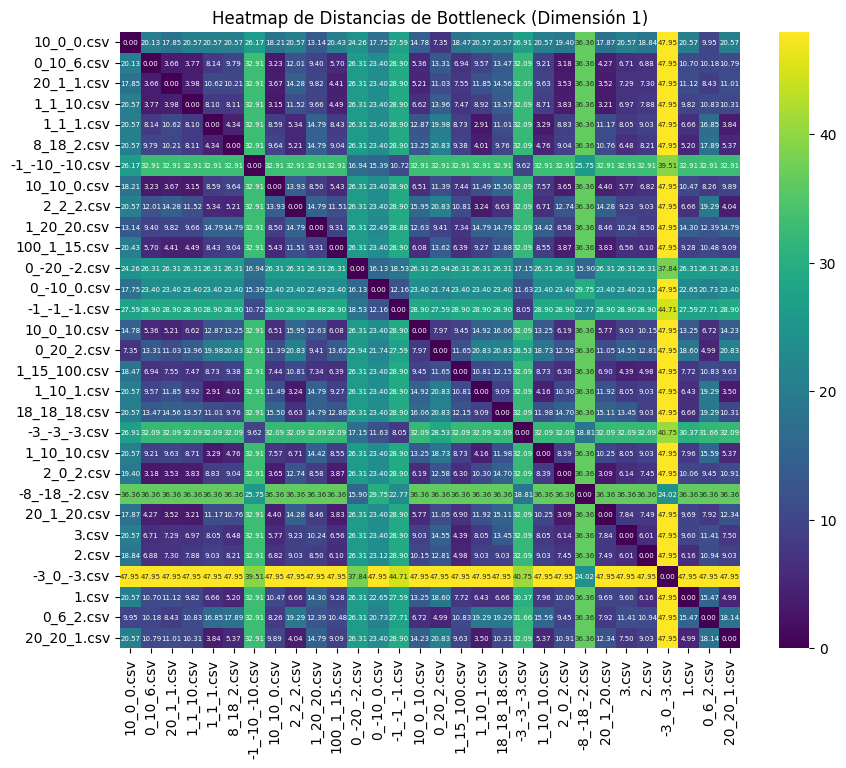

/opt/tljh/user/lib/python3.9/site-packages/seaborn/matrix.py:530: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage = hierarchy.linkage(self.array, method=self.method,
/opt/tljh/user/lib/python3.9/site-packages/seaborn/matrix.py:530: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage = hierarchy.linkage(self.array, method=self.method,


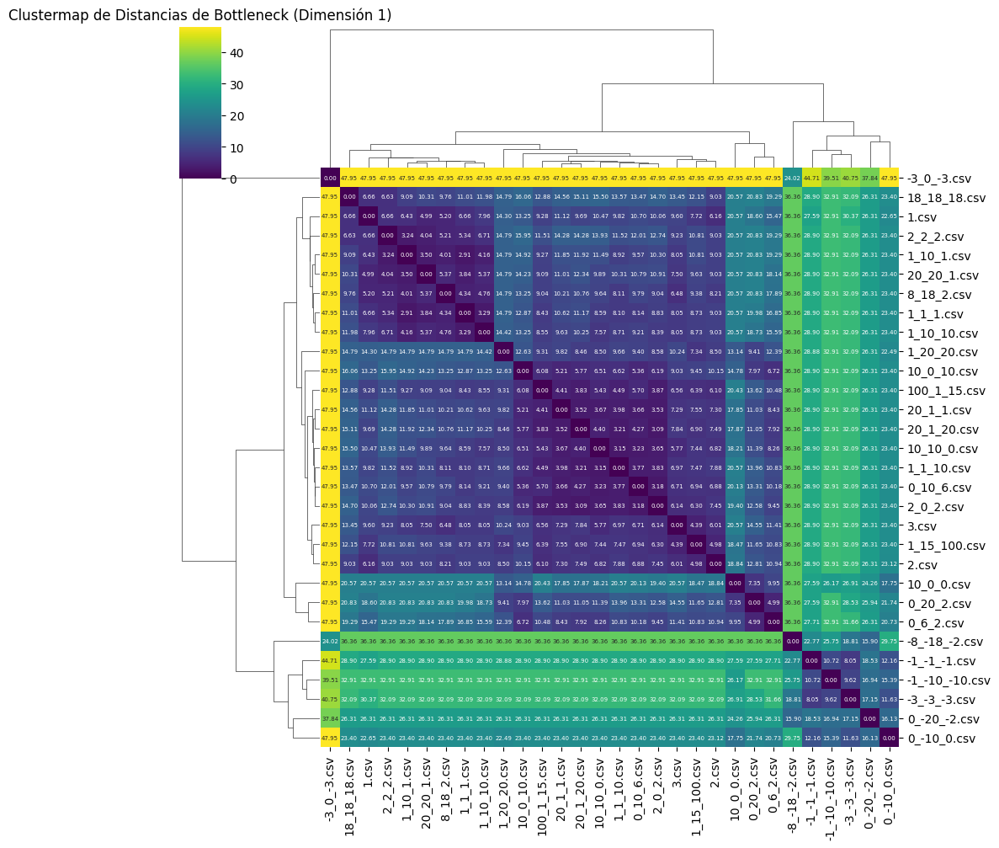

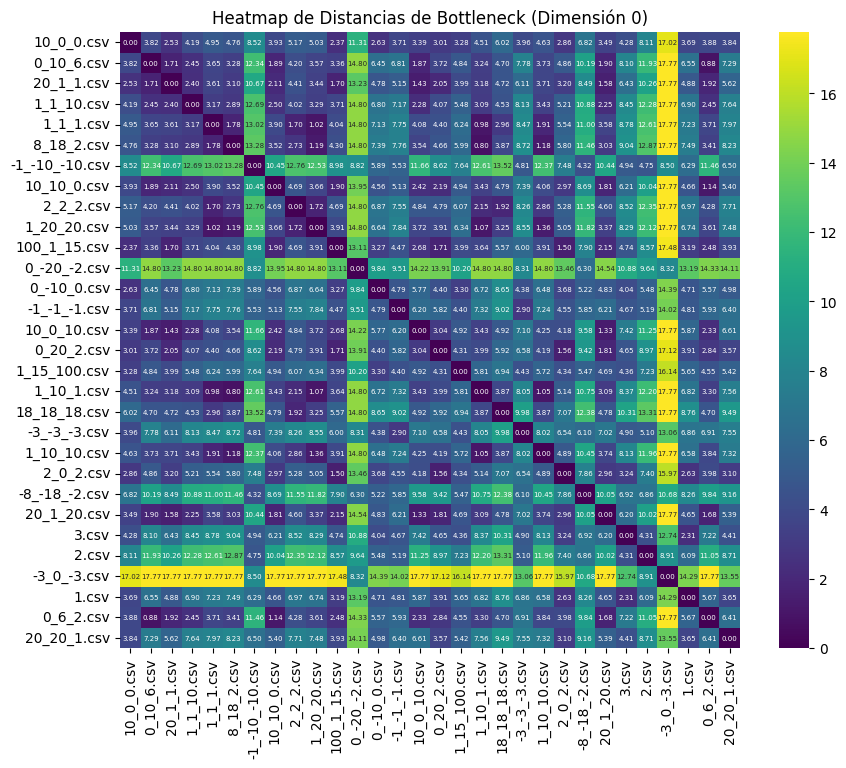

/opt/tljh/user/lib/python3.9/site-packages/seaborn/matrix.py:530: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage = hierarchy.linkage(self.array, method=self.method,
/opt/tljh/user/lib/python3.9/site-packages/seaborn/matrix.py:530: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  linkage = hierarchy.linkage(self.array, method=self.method,


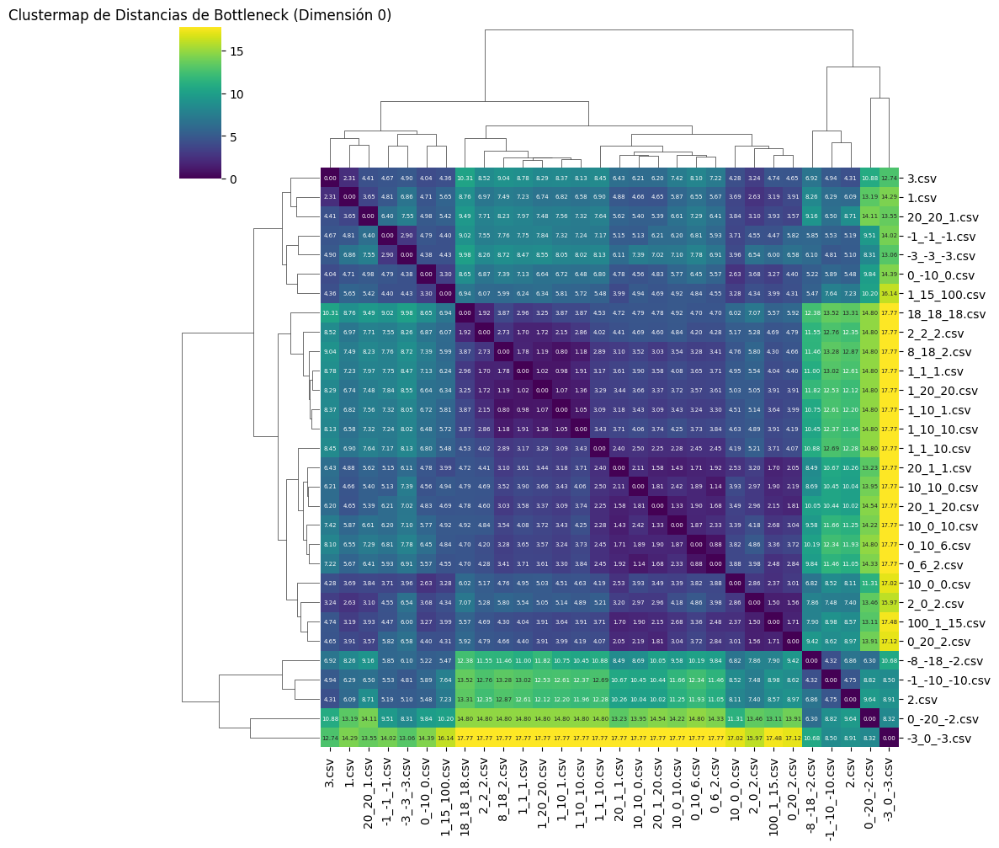

In [20]:
plot_heatmap_and_clustermap(distancias_dim1, "Distancias de Bottleneck (Dimensión 1)")
plot_heatmap_and_clustermap(distancias_dim0, "Distancias de Bottleneck (Dimensión 0)")

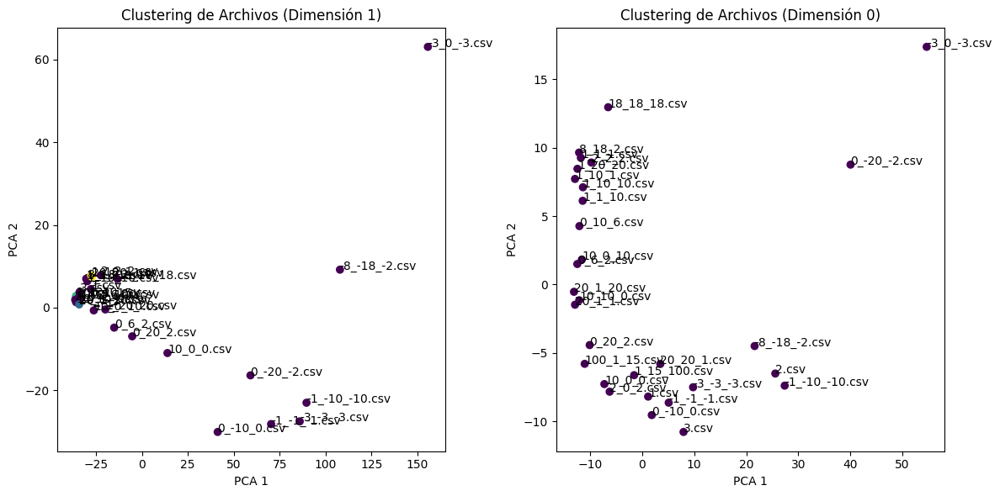

In [21]:
from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN

# Aplicar PCA a las matrices de distancias
pca = PCA(n_components=2)

# Reducción de dimensionalidad para la matriz de distancias de dimensión 1
distancias_dim1_reducidas = pca.fit_transform(distancias_dim1)

# Reducción de dimensionalidad para la matriz de distancias de dimensión 0
distancias_dim0_reducidas = pca.fit_transform(distancias_dim0)

# Aplicar DBSCAN a las distancias reducidas de dimensión 1
dbscan_dim1 = DBSCAN(eps=0.5, min_samples=2).fit(distancias_dim1_reducidas)
labels_dim1 = dbscan_dim1.labels_

# Aplicar DBSCAN a las distancias reducidas de dimensión 0
dbscan_dim0 = DBSCAN(eps=0.5, min_samples=2).fit(distancias_dim0_reducidas)
labels_dim0 = dbscan_dim0.labels_

# Visualización de los resultados del clustering
plt.figure(figsize=(12, 6))

# Visualización para la dimensión 1
plt.subplot(1, 2, 1)
plt.scatter(distancias_dim1_reducidas[:, 0], distancias_dim1_reducidas[:, 1], c=labels_dim1, cmap='viridis')
for i, txt in enumerate(archivos):
    plt.annotate(txt, (distancias_dim1_reducidas[i, 0], distancias_dim1_reducidas[i, 1]))
plt.title('Clustering de Archivos (Dimensión 1)')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')

# Visualización para la dimensión 0
plt.subplot(1, 2, 2)
plt.scatter(distancias_dim0_reducidas[:, 0], distancias_dim0_reducidas[:, 1], c=labels_dim0, cmap='viridis')
for i, txt in enumerate(archivos):
    plt.annotate(txt, (distancias_dim0_reducidas[i, 0], distancias_dim0_reducidas[i, 1]))
plt.title('Clustering de Archivos (Dimensión 0)')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')

plt.tight_layout()
plt.show()


/opt/tljh/user/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/opt/tljh/user/lib/python3.9/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/opt/tljh/user/lib/python3.9/site-packages/umap/distances.py:1086: NumbaDeprecationWarning: The 'nopython' keywo

              precision    recall  f1-score   support

          -1       0.33      0.33      0.33         3
           0       0.00      0.00      0.00         0
           1       0.67      1.00      0.80         2
           2       0.50      1.00      0.67         1
           3       0.00      0.00      0.00         2
           4       0.00      0.00      0.00         1

    accuracy                           0.44         9
   macro avg       0.25      0.39      0.30         9
weighted avg       0.31      0.44      0.36         9

[[1 1 1 0 0 0]
 [0 0 0 0 0 0]
 [0 0 2 0 0 0]
 [0 0 0 1 0 0]
 [2 0 0 0 0 0]
 [0 0 0 1 0 0]]


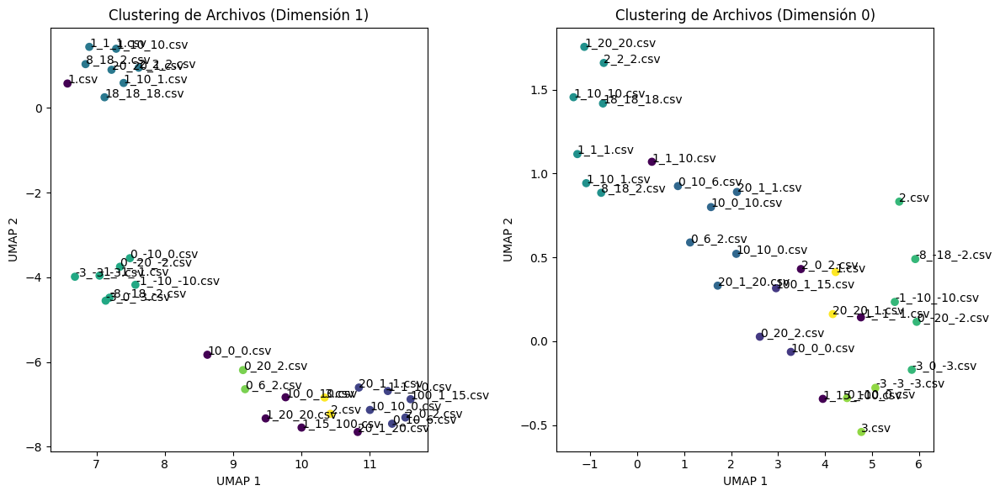

In [22]:
import numpy as np
import gudhi as gd
import os
import pandas as pd
import matplotlib.pyplot as plt
import umap.umap_ as umap
from sklearn.cluster import DBSCAN
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.ensemble import RandomForestClassifier

# Aplicar UMAP a las matrices de distancias
umap_reductor = umap.UMAP(n_components=2)

# Reducción de dimensionalidad para la matriz de distancias de dimensión 1
distancias_dim1_reducidas = umap_reductor.fit_transform(distancias_dim1)

# Reducción de dimensionalidad para la matriz de distancias de dimensión 0
distancias_dim0_reducidas = umap_reductor.fit_transform(distancias_dim0)

# Aplicar DBSCAN a las distancias reducidas de dimensión 1
dbscan_dim1 = DBSCAN(eps=0.5, min_samples=2).fit(distancias_dim1_reducidas)
labels_dim1 = dbscan_dim1.labels_

# Aplicar DBSCAN a las distancias reducidas de dimensión 0
dbscan_dim0 = DBSCAN(eps=0.5, min_samples=2).fit(distancias_dim0_reducidas)
labels_dim0 = dbscan_dim0.labels_

# Combinar las etiquetas de los clusters con los nombres de los archivos
datos_clustering = pd.DataFrame({
    'Archivo': archivos,
    'Cluster_Dim1': labels_dim1,
    'Cluster_Dim0': labels_dim0
})

# Entrenar un clasificador supervisado para la clasificación de nuevos archivos
X = np.hstack((distancias_dim1_reducidas, distancias_dim0_reducidas))
y = labels_dim1  # Usar las etiquetas de la dimensión 1 como objetivo

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Entrenar un clasificador, por ejemplo, un RandomForestClassifier
clf = RandomForestClassifier(n_estimators=100, random_state=42)
clf.fit(X_train, y_train)

# Predecir y evaluar el clasificador
y_pred = clf.predict(X_test)
print(classification_report(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))

# Visualización de los resultados del clustering
plt.figure(figsize=(12, 6))

# Visualización para la dimensión 1
plt.subplot(1, 2, 1)
plt.scatter(distancias_dim1_reducidas[:, 0], distancias_dim1_reducidas[:, 1], c=labels_dim1, cmap='viridis')
for i, txt in enumerate(archivos):
    plt.annotate(txt, (distancias_dim1_reducidas[i, 0], distancias_dim1_reducidas[i, 1]))
plt.title('Clustering de Archivos (Dimensión 1)')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')

# Visualización para la dimensión 0
plt.subplot(1, 2, 2)
plt.scatter(distancias_dim0_reducidas[:, 0], distancias_dim0_reducidas[:, 1], c=labels_dim0, cmap='viridis')
for i, txt in enumerate(archivos):
    plt.annotate(txt, (distancias_dim0_reducidas[i, 0], distancias_dim0_reducidas[i, 1]))
plt.title('Clustering de Archivos (Dimensión 0)')
plt.xlabel('UMAP 1')
plt.ylabel('UMAP 2')

plt.tight_layout()
plt.show()